#  CV Homework 3 — Stereo Vision, Depth & Object Size Estimation

---

##  Overview
In this homework, you will build your own **stereo camera setup** using two webcameras or smartphones, perform **stereo calibration**, compute **depth maps**, detect **humans using YOLO**, and estimate **real-world distances** and **object sizes**.

---

### Important Notes
- You **must capture your own stereo images**.  
- Disable autofocus on your cameras and fix the focal length for all the captured images.  
- Keep cameras static during capture.  
- Capture a **checkerboard calibration dataset** and **scene images** with people and a reference object (cup).

---

## Goals
1. Calibrate a stereo camera using OpenCV.
2. Compute disparity and depth maps.
3. Detect humans with YOLO.
4. Estimate distances to humans.
5. Estimate a person’s height using a known-size reference object (cup).

---


In [ ]:
#!pip -q install gdown
#!gdown --folder --id 1O7KP8Zj8MkJpEOM3o6vb4HrOMHq6DVdi -O data
#!ls -lah data

In [2]:
%matplotlib inline
from matplotlib import pyplot as plt
from IPython.display import clear_output
plt.rcParams["figure.figsize"] = (16, 10) # (w, h)
import numpy as np
import time
import cv2
import math
from pathlib import Path
import re, cv2
import matplotlib.pyplot as plt


def showInRow(list_of_images, titles = None, disable_ticks = False):
  count = len(list_of_images)
  for idx in range(count):
    subplot = plt.subplot(1, count, idx+1)
    if titles is not None:
      subplot.set_title(titles[idx])

    img = list_of_images[idx]
    cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
    subplot.imshow(img, cmap=cmap)
    if disable_ticks:
      plt.xticks([]), plt.yticks([])
  plt.show()

## Part I — Stereo Camera Calibration

###  Task 1: Capture Checkerboard Images (5%)
Capture **N pairs** of checkerboard images using your stereo setup (more than 10 pairs for better results).

- The checkerboard must be visible from both cameras.  
- Save images as `left01.jpg`, `right01.jpg`, `left02.jpg`, `right02.jpg`, ...  


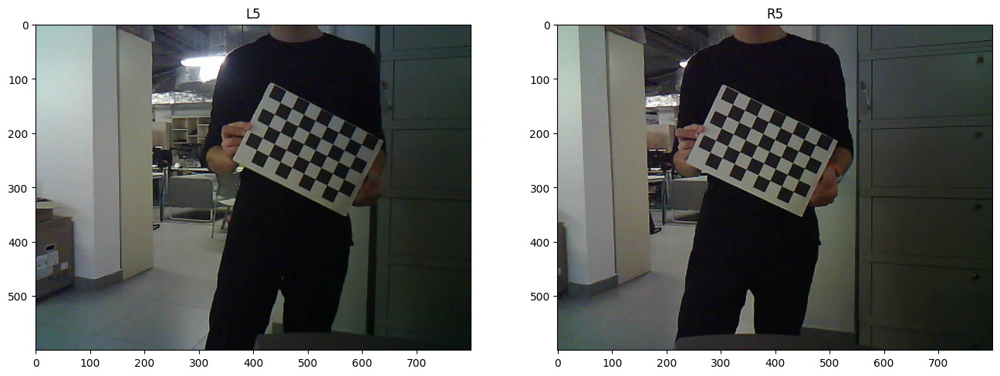

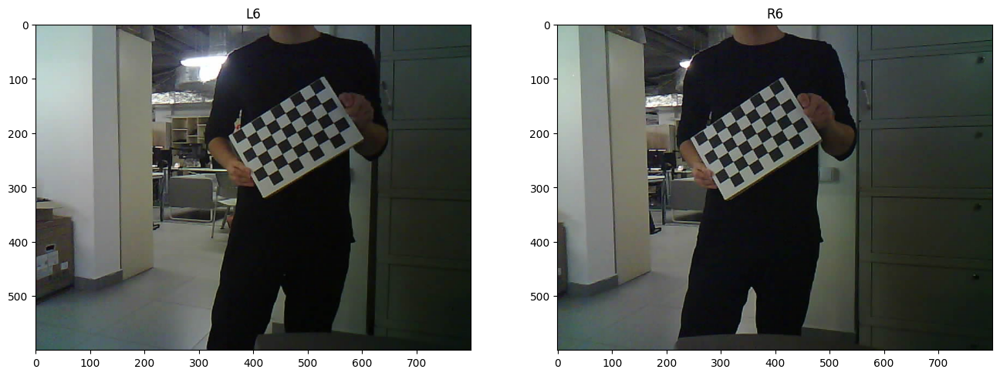

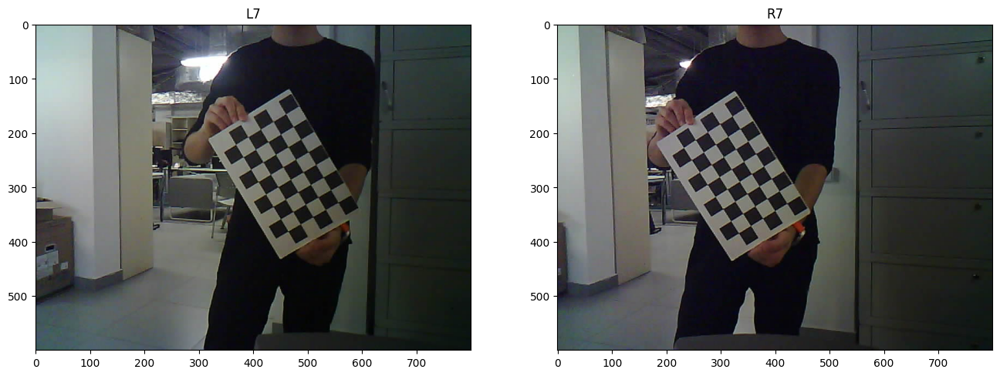

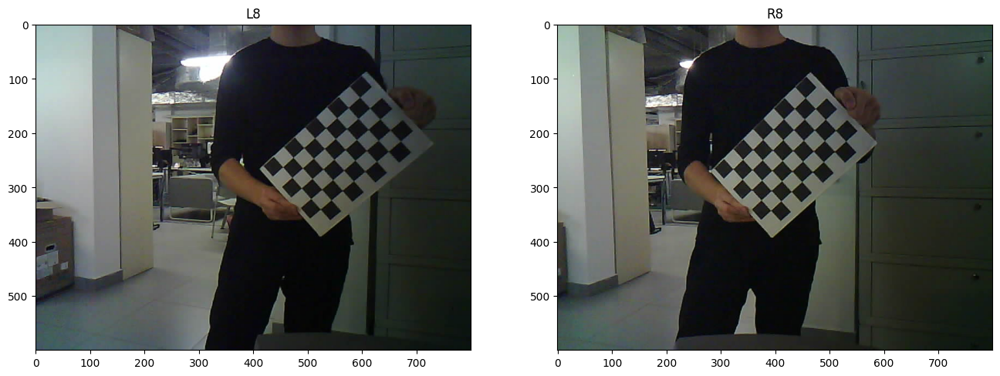

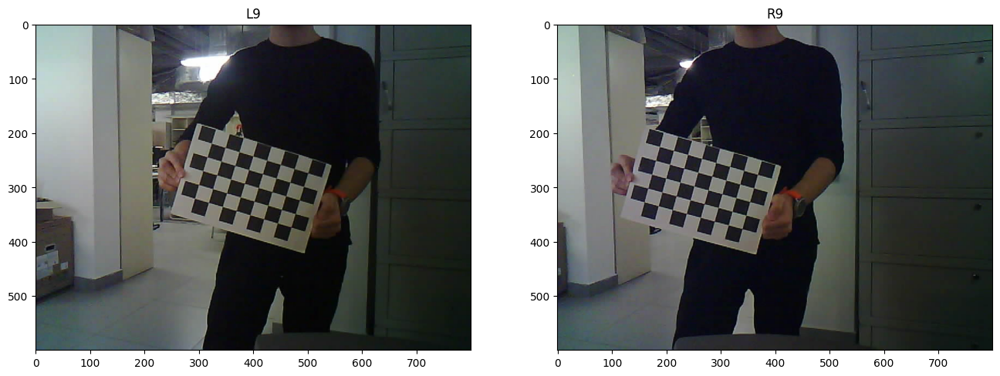

...

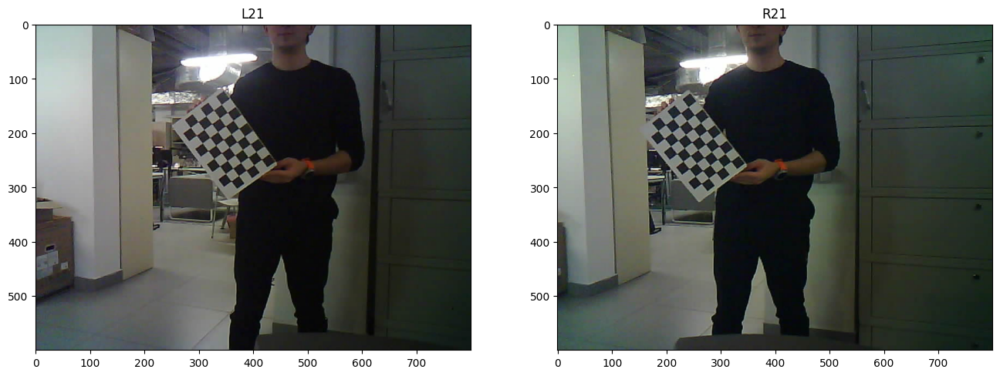

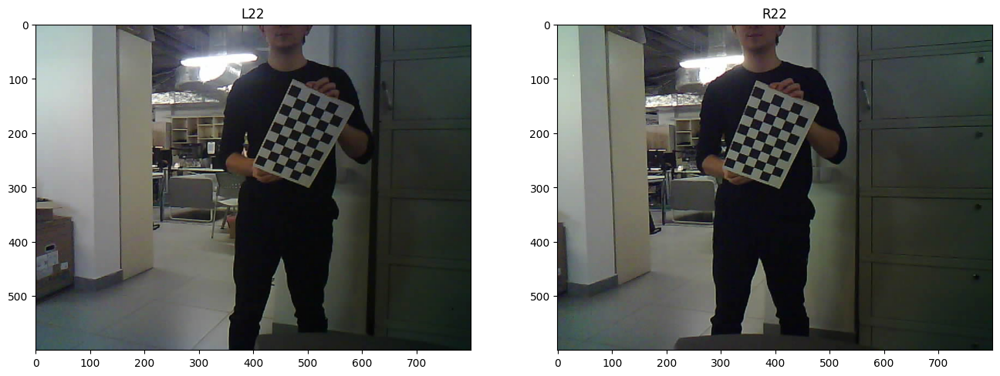

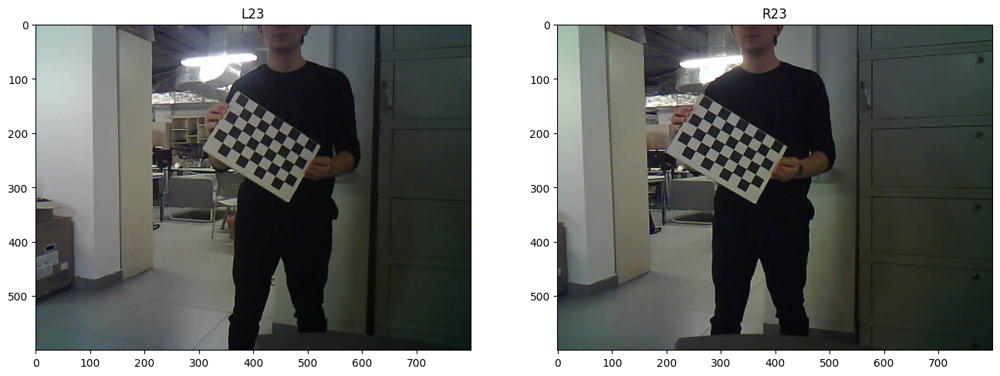

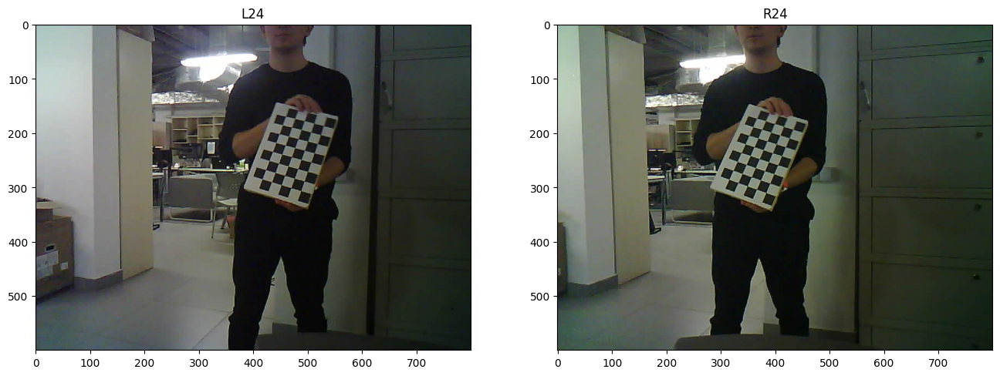

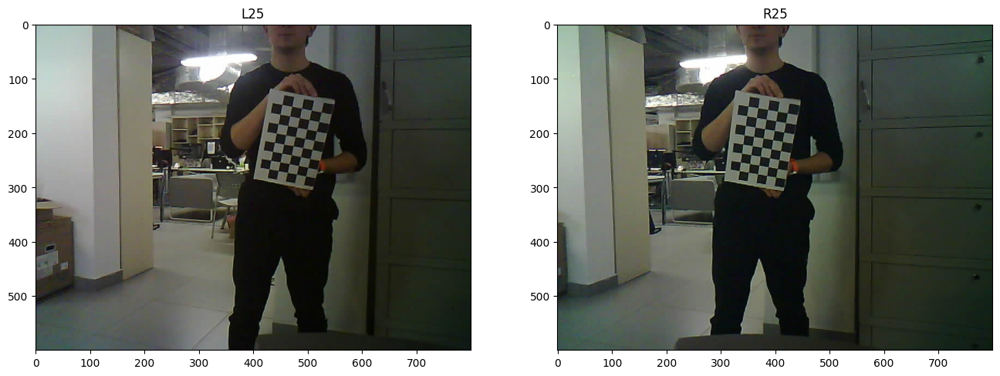

In [21]:
# images are saved in /data folder
root = Path("data")
left_files  = sorted(root.rglob("L*.jpg"))
right_files = sorted(root.rglob("R*.jpg"))

# pair by numeric index extracted from filename
pat = re.compile(r'^(L|R)\D*(\d+)', re.IGNORECASE)
L = {int(m.group(2)): p for p in left_files  if (m:=pat.search(p.name))}
R = {int(m.group(2)): p for p in right_files if (m:=pat.search(p.name))}
idx = sorted(set(L) & set(R))
if not idx:
    raise RuntimeError("No matching L*/R* pairs found in ./data")

# load pairs (BGR->RGB for display)
left, right = [], []
for k in idx:
    li = cv2.imread(str(L[k]), cv2.IMREAD_COLOR)
    ri = cv2.imread(str(R[k]), cv2.IMREAD_COLOR)
    if li is None or ri is None:
        raise RuntimeError(f"Failed to read pair {k}: {L[k]} or {R[k]}")
    left.append(cv2.cvtColor(li, cv2.COLOR_BGR2RGB))
    right.append(cv2.cvtColor(ri, cv2.COLOR_BGR2RGB))

# preview all pairs
for i, k in enumerate(idx):
    showInRow([left[i], right[i]], titles=[f"L{k}", f"R{k}"])

### Task 2: Detect Checkerboard Corners (5%)

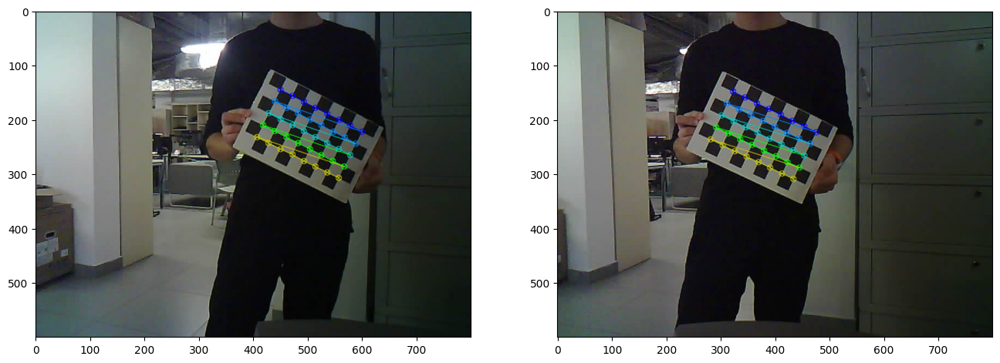

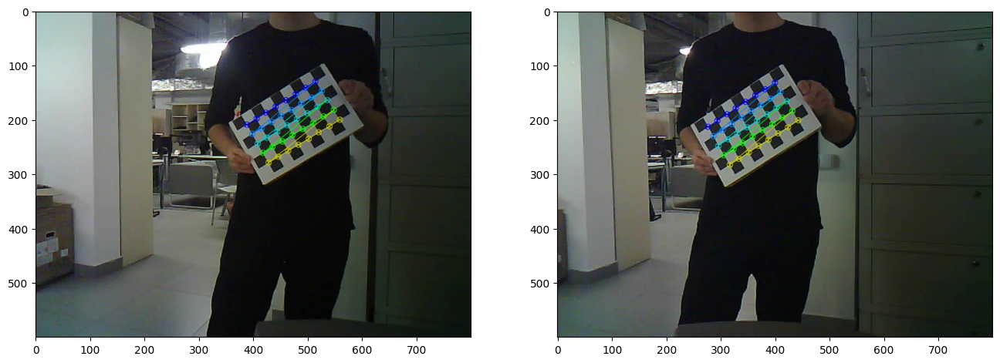

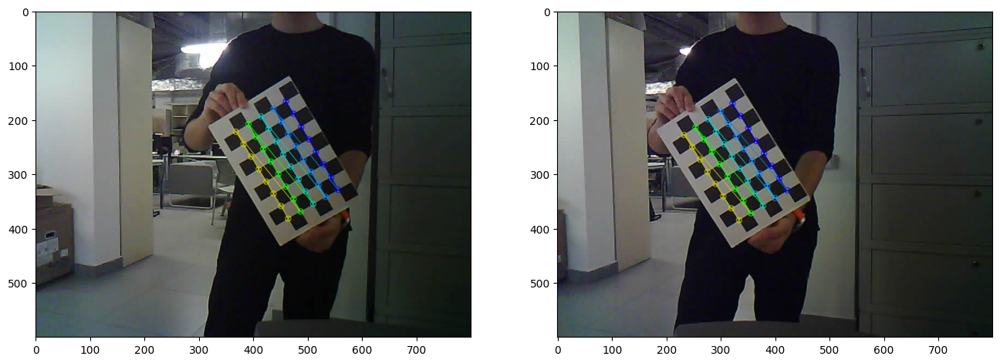

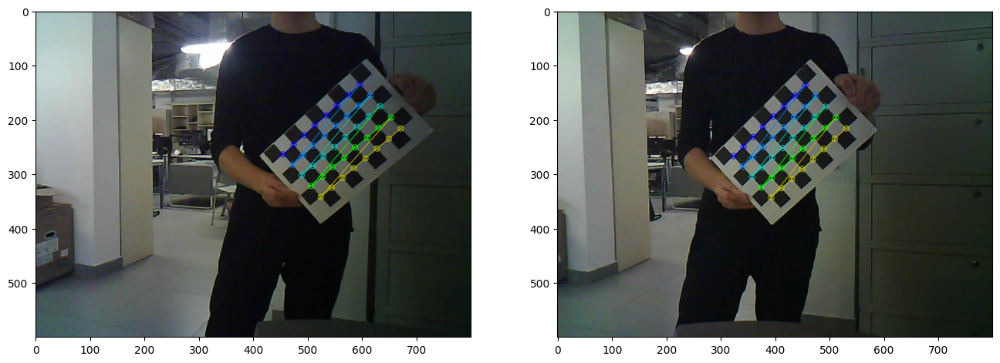

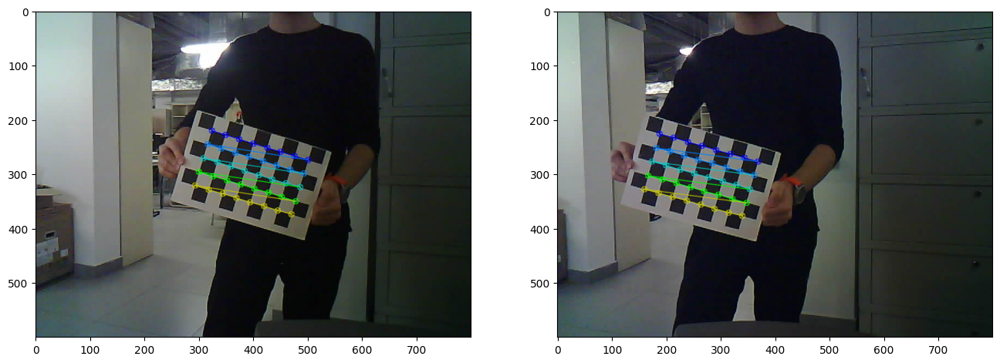

...

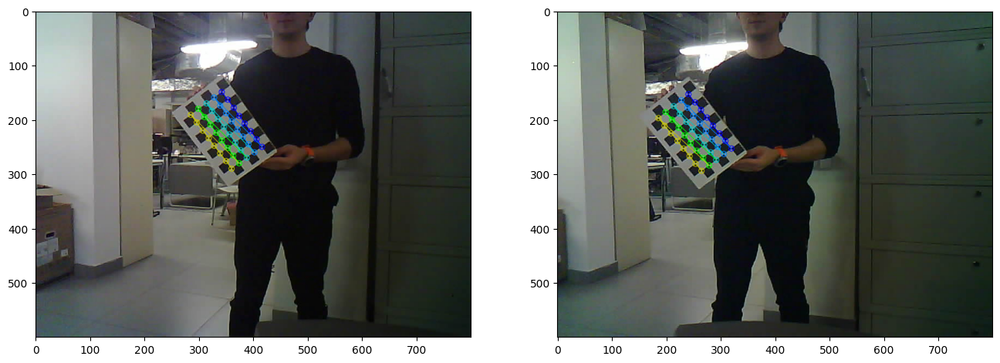

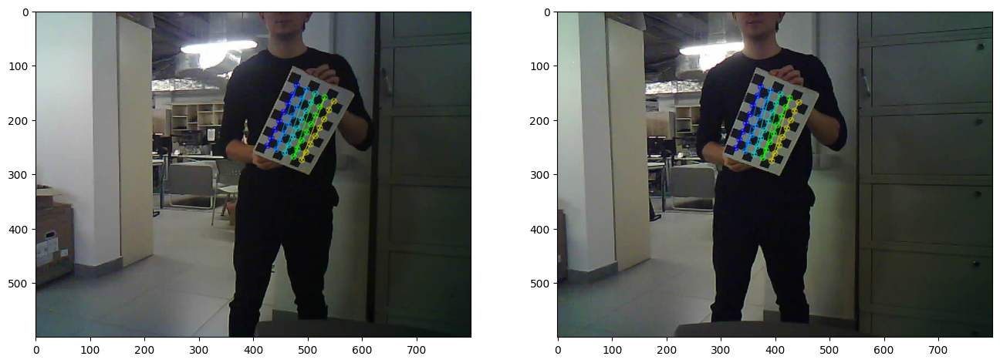

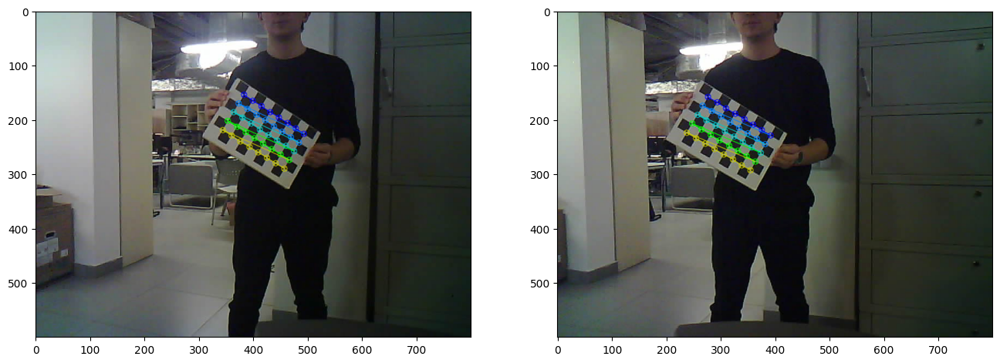

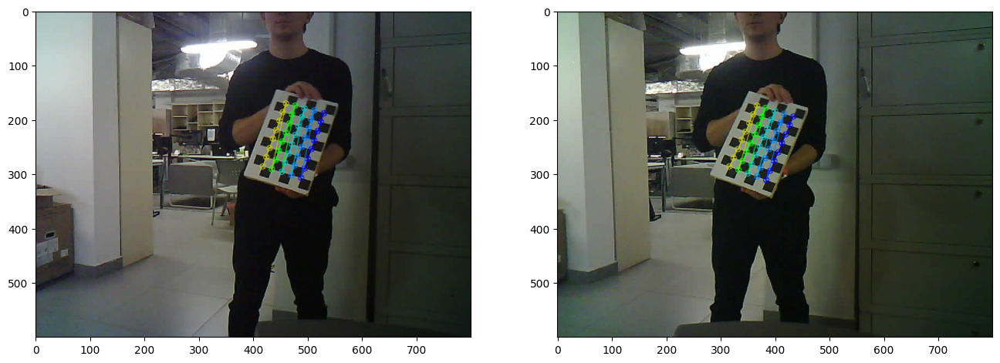

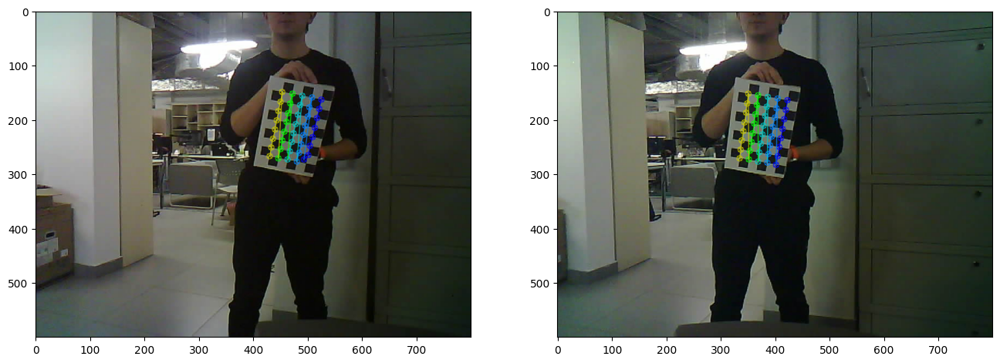

In [22]:

# TODO: Detect checkerboard corners in all image pairs.
# Hint: use cv2.findChessboardCorners(gray, (cols, rows))
# and cv2.cornerSubPix() to refine corner accuracy.
# inner corners count (cols, rows); tune to your board
pattern_size = (8,5)
# square size in real units (e.g. mm); tune to your print
square_size = 30

# prepare 3d points of the checkerboard on z=0 plane
pattern_points = np.zeros((np.prod(pattern_size), 3), np.float32)
pattern_points[:, :2] = np.indices(pattern_size).T.reshape(-1, 2)
pattern_points *= square_size

# holders for calibration points
objpoints = []                      # 3d points in board coords
imgpoints_left, imgpoints_right = [], []  # 2d points in image coords

# subpixel refinement stop criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-3)

for i, (l, r) in enumerate(zip(left, right), start=1):
  # convert to grayscale for corner detection
  gl = cv2.cvtColor(l, cv2.COLOR_RGB2GRAY) if l.ndim == 3 else l
  gr = cv2.cvtColor(r, cv2.COLOR_RGB2GRAY) if r.ndim == 3 else r

  # detect corners on left
  foundl, cornersl = cv2.findChessboardCorners(gl, pattern_size)
  if foundl:
    cornersl = cv2.cornerSubPix(gl, cornersl, (5,5), (-1,-1), criteria)
    imgpoints_left.append(cornersl)

  # detect corners on right
  foundr, cornersr = cv2.findChessboardCorners(gr, pattern_size)
  if foundr:
    cornersr = cv2.cornerSubPix(gr, cornersr, (5,5), (-1,-1), criteria)
    imgpoints_right.append(cornersr)

  # use the pair only if both sides were detected
  if foundl and foundr:
    objpoints.append(pattern_points)

  # visualize detections for quick sanity check
  visL = cv2.drawChessboardCorners(l.copy(), pattern_size, cornersl, foundl) if foundl else l
  visR = cv2.drawChessboardCorners(r.copy(), pattern_size, cornersr, foundr) if foundr else r
  showInRow([visL, visR])

# Example variables:
# CHECKERBOARD = (9,6)
# objpoints = []  # 3D points
# imgpoints_left, imgpoints_right = [], []  # 2D image points for each camera


### Task 3: Calibrate Each Camera (5%)

In [23]:
# TODO: Calibrate each camera using cv2.calibrateCamera()
# Inputs: objpoints, imgpoints_left/right, image_size
# Outputs: cameraMatrix, distCoeffs, rvecs, tvecs

# Left
rms_L, cameraMatrix_L, distCoeffs_L, rvecs_L, tvecs_L = cv2.calibrateCamera(
    objpoints, imgpoints_left, (left[0].shape[1], left[0].shape[0]), None, None
)

# Right
rms_R, cameraMatrix_R, distCoeffs_R, rvecs_R, tvecs_R = cv2.calibrateCamera(
    objpoints, imgpoints_right, (left[0].shape[1], left[0].shape[0]), None, None
)

print("Left K:\n", cameraMatrix_L, "\nLeft D:\n", distCoeffs_L.ravel(), "\nRMS:", rms_L, "\nRvecs",rvecs_L,"\nTvecs",tvecs_L)
print()
print("Right K:\n", cameraMatrix_R, "\nRight D:\n", distCoeffs_R.ravel(), "\nRMS:", rms_R,"\nRvecs",rvecs_R,"\nTvecs",tvecs_R)


Left K:
 [[     729.25           0      412.42]
 [          0       724.7      334.67]
 [          0           0           1]] 
Left D:
 [   0.064219     -1.1926   0.0029825  -0.0072964      5.9056] 
RMS: 0.5500655847417021 
Rvecs (array([[   0.048538],
       [  -0.059479],
       [    0.46025]]), array([[   -0.14957],
       [    0.22961],
       [   -0.51396]]), array([[    0.14431],
       [   0.040126],
       [     1.0331]]), array([[  0.0018673],
       [    0.24044],
       [   -0.71868]]), array([[   0.024462],
       [  -0.028347],
       [    0.29517]]), array([[   0.058136],
       [   0.027501],
       [    0.26833]]), array([[  -0.083176],
       [     0.2909],
       [    -2.3099]]), array([[   0.015489],
       [   0.057125],
       [   0.018486]]), array([[   0.083066],
       [  -0.057154],
       [    0.76029]]), array([[   0.026921],
       [    0.23374],
       [    -1.0393]]), array([[ -0.0089041],
       [   0.031643],
       [   0.076161]]), array([[ -0.0080309]

### Task 4: Stereo Calibration (5%)

In [6]:

# TODO: Perform stereo calibration using cv2.stereoCalibrate()
# Hint: pass both cameras’ intrinsics and distortion coefficients
# Outputs: R, T, E, F (rotation, translation, essential, and fundamental matrices)

# calibrate stereo camera
rms, K_L, D_L, K_R, D_R, R, T, E, F = cv2.stereoCalibrate(objpoints,
                              imgpoints_left,imgpoints_right,
                              cameraMatrix_L,distCoeffs_L,cameraMatrix_R,distCoeffs_R,
                              (left[0].shape[1], left[0].shape[0]),criteria=criteria,flags=cv2.CALIB_FIX_INTRINSIC)
# size for future code
image_size= (left[0].shape[1], left[0].shape[0])

# print some things
print(f"stereo RMS: {rms:.4f}")
print("R:\n", R)
print("T:\n", T, "  \nbaseline =", float(np.linalg.norm(T))) # well, it's pretty good approx, almost true
print("E:\n", E)
print("F:\n", F)

stereo RMS: 1.1030
R:
 [[ 0.99931909  0.01482867 -0.03378566]
 [-0.01701755  0.99771081 -0.06544879]
 [ 0.0327378   0.06597918  0.9972838 ]]
T:
 [[-119.73911709]
 [  15.84273084]
 [ -71.25292854]]   
baseline = 140.2334771258512
E:
 [[  -0.69389386   72.13510733   11.13628069]
 [ -67.28441683    6.84370204  121.82120907]
 [ -13.79427747 -119.69993807    8.37203777]]
F:
 [[ 3.28256801e-07 -3.43151836e-05  7.10546700e-03]
 [ 3.20847113e-05 -3.28166083e-06 -5.83820530e-02]
 [-7.45712752e-03  5.67024480e-02  1.00000000e+00]]


###  Task 5: Rectification and Map Creationv (5%)

In [7]:

# TODO: Compute rectification transforms using cv2.stereoRectify()
# and cv2.initUndistortRectifyMap()
# Save rectification maps for later use.

# compute rectification transforms for left and right cameras
R1, R2, P1, P2, Q, roi1, roi2 = cv2.stereoRectify(
    K_L, D_L, K_R, D_R, image_size, R, T, flags=cv2.CALIB_ZERO_DISPARITY
)

# generate undistortion/rectification map for left image
map1_Lx, map2_Ly = cv2.initUndistortRectifyMap(K_L, D_L, R1, P1, image_size, cv2.CV_16SC2)

# generate undistortion/rectification map for right image
map1_Rx, map2_Ry = cv2.initUndistortRectifyMap(K_R, D_R, R2, P2, image_size, cv2.CV_16SC2)


## Part II — Depth Map Computation (15%)

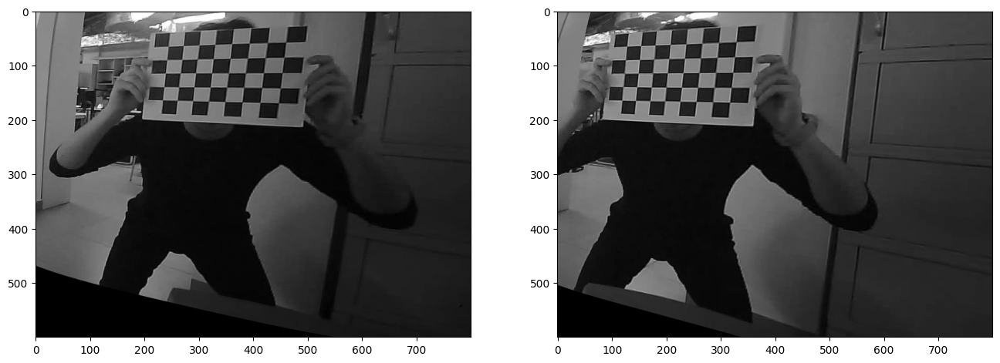

In [8]:
# TODO: Load a pair of rectified stereo images (left, right)

# Convert to grayscale
# apply rectification maps to the 8th left and right frames
L = cv2.remap(left[7],map1_Lx,map2_Ly, cv2.INTER_LANCZOS4, cv2.BORDER_CONSTANT, 0)
R = cv2.remap(right[7],map1_Rx,map2_Ry, cv2.INTER_LANCZOS4, cv2.BORDER_CONSTANT, 0)

# convert rectified images to grayscale
grayL = cv2.cvtColor(L, cv2.COLOR_BGR2GRAY)
grayR = cv2.cvtColor(R, cv2.COLOR_BGR2GRAY)

# display the two grayscale images side by side
showInRow([grayL,grayR])


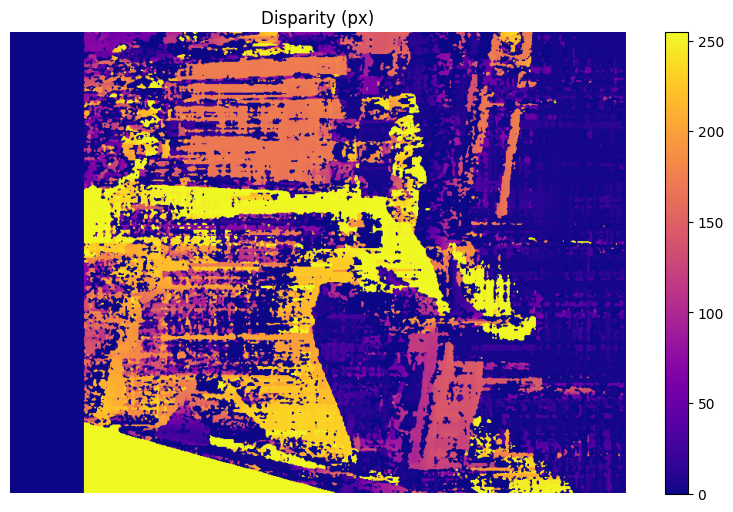

In [9]:

# TODO: Compute disparity map
# Hint: use cv2.StereoBM_create() or cv2.StereoSGBM_create()

# parameters for the block matching algorithm
window_size = 3         # size of the matching block (odd number)
min_disp = 0            # minimum possible disparity value
num_disp = 16 * 6       # range of disparity values (must be multiple of 16)

# create a StereoSGBM matcher with the chosen parameters
stereo = cv2.StereoSGBM_create(
    minDisparity=min_disp,
    numDisparities=num_disp,
    blockSize=window_size,
    P1=8 * 1 * window_size**2,
    P2=32 * 1 * window_size**2,
    disp12MaxDiff=3,
    uniquenessRatio=5,
    speckleWindowSize=0,
    speckleRange=0,
    mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
)
# compute raw disparity (scaled by 16) and convert to float32
disparity_map = stereo.compute(grayL, grayR).astype(np.float32) / 16.0
# normalize disparity to 0‑255 for visualisation and cast to 8‑bit image
disparity_map = cv2.normalize(disparity_map, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
# plot the normalised disparity map
plt.figure(figsize=(10,6))
plt.imshow(disparity_map, cmap='plasma')
plt.title('Disparity (px)'); plt.axis('off'); plt.colorbar()

# Visualize using matplotlib
# plt.imshow(disparity, cmap='plasma')


## Part III — Human Detection (YOLO) (10%)

In [10]:
!pip -q install ultralytics

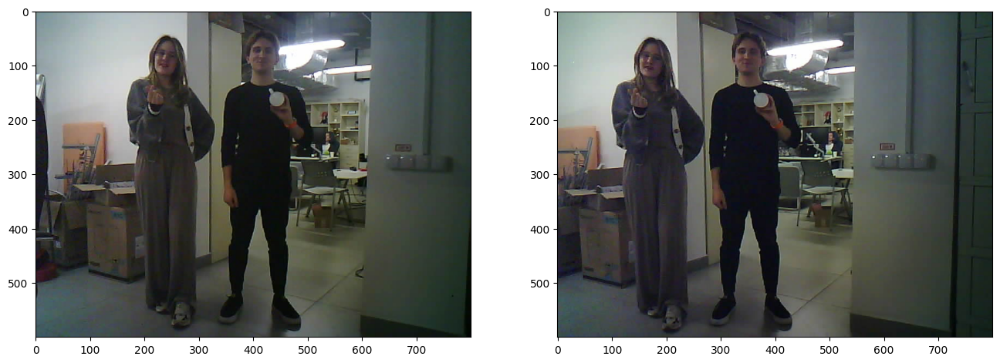

In [11]:
root = Path("data")

# load human images
human_left = cv2.imread("data/HumanL.jpg", cv2.IMREAD_COLOR)
human_left = cv2.cvtColor(human_left, cv2.COLOR_BGR2RGB)

human_right = cv2.imread("data/HumanR.jpg", cv2.IMREAD_COLOR)
human_right = cv2.cvtColor(human_right,cv2.COLOR_BGR2RGB)

showInRow([human_left, human_right])


0: 480x640 2 persons, 410.2ms
Speed: 12.5ms preprocess, 410.2ms inference, 8.2ms postprocess per image at shape (1, 3, 480, 640)


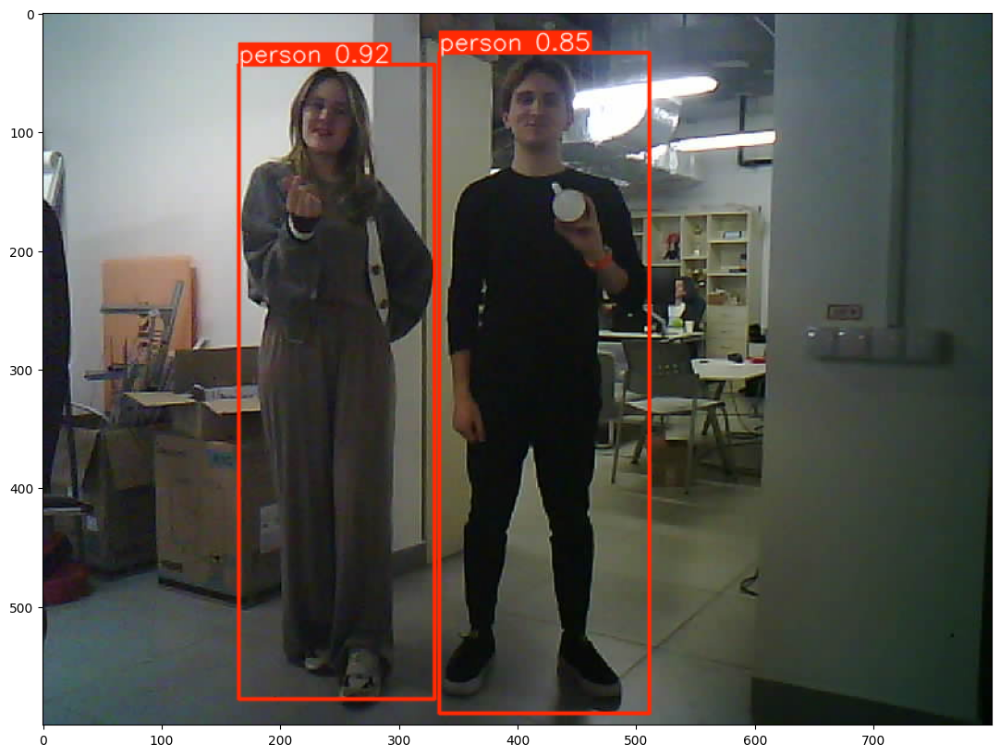

In [12]:
# TODO: Load YOLO model and perform human detection on left image.
# Filter detections by class label 'person'

from ultralytics import YOLO
# load model
model = YOLO('yolo12n.pt')
# get a predict only for humans
results = model(human_left,classes=[0])
# visualise
r = results[0]
vis = r.plot()
showInRow([vis])

## Part IV — Distance Estimation (20%)

In [13]:

# TODO: Compute distance to each detected person using disparity.
# Use Z = f * B / d, where:
# f: focal length (from calibration)
# B: baseline distance between cameras
# d: mean disparity within the bounding box of the person

# focal length (in pixels) from the left camera projection matrix
fx = float(P1[0,0])
# baseline distance between the two camera centers
# extracted from the right camera projection matrix and divided by fx
baseline_m = abs(float(P2[0, 3]) / fx)

def person_distance(disparity_map, box, fx, baseline_m):
    """
    estimate distance (meters) to a person given a bounding box

    args:
        disparity_map – normalized disparity image (uint8)
        box          – (x1, y1, x2, y2) coordinates of the detection
        fx           – focal length in pixels
        baseline_m   – camera baseline in meters
    returns:
        Z (float) – distance in meters, or NaN if no valid disparity
    """
    # unpack box coordinates and cast to int for indexing
    x1,y1,x2,y2 = map(int, box)
    # region of interest inside the bounding box
    roi = disparity_map[y1:y2, x1:x2]
    # keep only positive disparity values (valid measurements)
    d = roi[roi > 0]
    q1, q3 = np.percentile(d, [25,75])
    d = d[(d >= q1) & (d <= q3)]
    if d.size == 0:
        return np.nan
    # median disparity of the filtered region
    d_med = np.median(d)
    # depth from the stereo triangulation formula Z = f * B / d
    Z = (fx * baseline_m) / d_med
    return Z

# detections from the object detector (e.g., YOLO) – convert to numpy array
boxes = r.boxes.xyxy.cpu().numpy()
# compute and print distance for each detected person
for x1,y1,x2,y2 in boxes:
    Z = person_distance(disparity_map, (x1,y1,x2,y2), fx, baseline_m)
    # convert from millimetres to metres for display
    print(f"Person @({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f}) | distance = {Z/1000:.2f} m")


Person @(166,44,331,578) | distance = 0.61 m
Person @(334,34,512,590) | distance = 0.61 m


## Part V — Height Estimation via Known Object (Cup) (10%)

### Scenario
The scene must include **two people**, one of them holding a **cup** showing its **bottom circle**.  
The **diameter of the cup is known** (e.g., 0.07 m).

You will:
1. Detect the cup’s circular bottom with the **Hough Circle Transform**.  
2. Measure the circle’s apparent diameter in pixels.  
3. Compute the pixel-to-meter ratio.  
4. Use YOLO bounding boxes to measure a person’s pixel height.  
5. Estimate real height in meters.


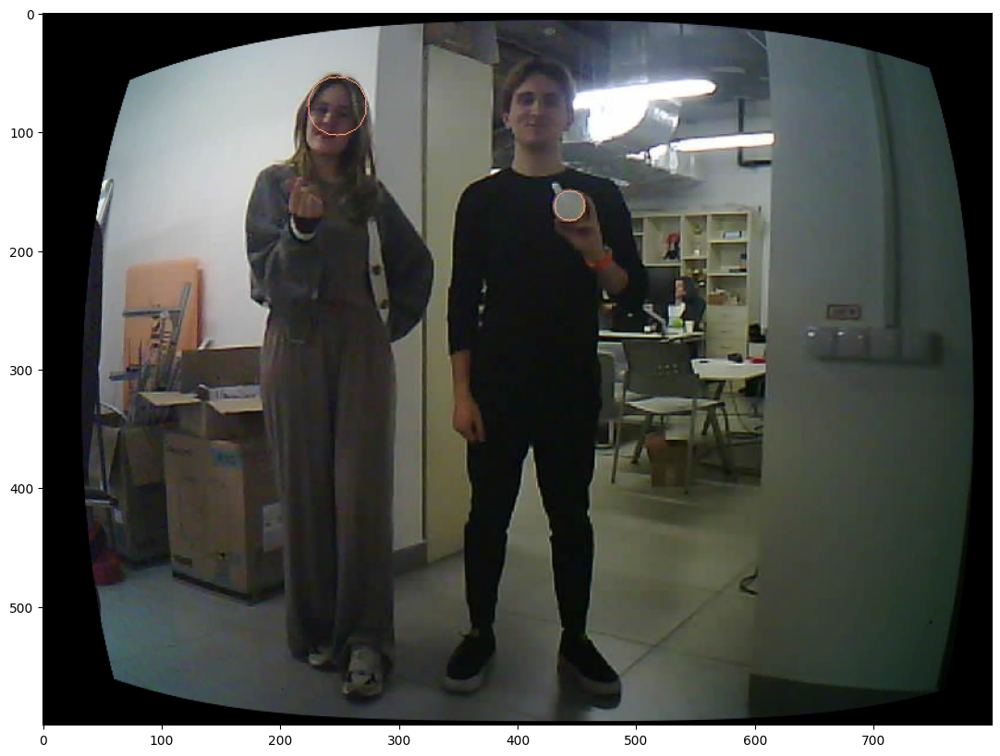

[[[248  78  25]
  [444 162  13]]]
Diameter: [50 26]


In [18]:

# TODO: Detect the circular bottom of the cup
# Hint: use cv2.HoughCircles()

cup_diameter_m = 72  # known cup diameter in milimeters
cup_diameter_px = 0

image = human_left
# remove lens distortion using the left camera calibration
img = cv2.undistort(image, cameraMatrix_L, distCoeffs_L)
# convert to grayscale for circle detection
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
# smooth image to reduce noise and improve Hough detection
blurred = cv2.GaussianBlur(gray, (9, 9), 2)
# detect circular objects (cups) in the blurred image
circles = cv2.HoughCircles(
    blurred,
    cv2.HOUGH_GRADIENT,
    dp=1,
    minDist=50,
    param1=50,
    param2=30,
    minRadius=10,
    maxRadius=50
)
# if any circles were found, draw them on the original image
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0,:]:
        cv2.circle(img, (i[0], i[1]), i[2], (255, 158, 128), 1)
# Show result
plt.plot()
plt.imshow(img)
plt.show()
# compute average cup diameter in pixels (diameter = 2 * radius)
cup_diameter_px = circles[0][:, 2]* 2

print(circles)
print("Diameter:", cup_diameter_px)

# let's choose the small one :D

cup_px: 26.0 m_per_px: 0.002769230769230769
heights_m: [(np.int64(165), np.int64(43), np.int64(330), np.int64(578), np.float64(1.4815384615384615)), (np.int64(334), np.int64(33), np.int64(511), np.int64(590), np.float64(1.5424615384615383))]


(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

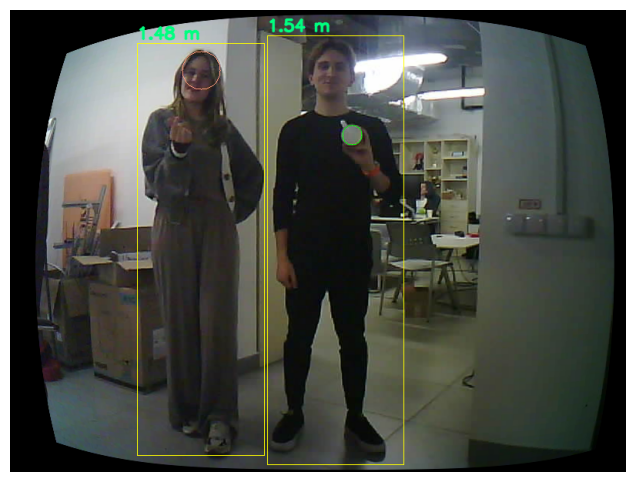

In [20]:

# TODO: Estimate the height of another person using YOLO bounding box height (in pixels)

circ = np.uint16(np.around(circles[0]))   # (N,3): x,y,r
idx = np.argmin(circ[:, 2])               # min
cx, cy, cr = circ[idx]
cup_px = float(cr * 2)

# visualize the selected circle
vis = img.copy()
cv2.circle(vis, (cx, cy), cr, (0, 255, 0), 1)

# convert pixels to meters using the known real cup diameter
# note: cup_diameter_m is in millimeters -> divide by 1000 for meters
m_per_px = (cup_diameter_m / 1000.0) / cup_px
# get yolo detections
boxes = r.boxes.xyxy.cpu().numpy().astype(int)
cls   = r.boxes.cls.int().cpu().numpy()
names = r.names
# compute person heights: bbox pixel height × meters-per-pixel
heights_m = []
for (x1,y1,x2,y2), c in zip(boxes, cls):
    if names[int(c)] != 'person':
        continue
    h_px = max(0, y2 - y1)    # pixel height of the bbox
    H_m  = h_px * m_per_px    # estimated height in meters
    heights_m.append((x1,y1,x2,y2,H_m))
    # draw bbox and height label
    cv2.rectangle(vis, (x1,y1), (x2,y2), (255,255,0), 1)
    cv2.putText(vis, f"{H_m:.2f} m", (x1, max(0,y1-6)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,255,128), 2, cv2.LINE_AA)

# quick logs
print("cup_px:", cup_px, "m_per_px:", m_per_px)
print("heights_m:", heights_m)
# show result
plt.figure(figsize=(10,6))
plt.imshow(vis); plt.axis('off')

## Reflection (10%)


1. What were the main sources of error in your calibration and measurements?  
- **Limited depth discretization** - a short baseline and limited image resolution cause coarse disparity steps, leading to under-estimated depths.  
- **Uneven illumination and shadows** - brightness differences between the two cameras break the stereo assumption of equal intensity and distort corner detection.  
- **Low contrast or dark regions** - weak texture and shadowed areas make it hard to detect corners and match pixels correctly.  

2. How could you improve your stereo setup to achieve more accurate depth results?
- Increase **baseline length or image resolution** to get finer disparity quantization.  
- Provide **uniform, diffused lighting** to avoid shadows and highlight both chessboard and scene texture.  
- Place the **reference object and target at the same depth** when converting pixel size to real units.  



---
###  Submission Instructions
- Submit this notebook with all code cells executed (file name should be YOUR_NAME_HW3).
- The code should be commented. (5%)
- Include a folder with your captured stereo images.
- Ensure all parameters are clearly documented.(5%)


# Useful resources :
- https://learnopencv.com/making-a-low-cost-stereo-camera-using-opencv/
- https://pub.towardsai.net/detecting-objects-with-yolov5-opencv-python-and-c-c7cf13d1483c
- https://learnopencv.com/introduction-to-epipolar-geometry-and-stereo-vision/